### Final annotation of Mesenchymal cells (second trimester)


Preprocessing:
- mesenchymal cells from main object subsetted, then subsetted cells from second trimester patients
- performed scvi batch correction to prepare objects

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/Mes_ST.hvg5000_noCC.scvi_output.with_annotv2.22021124.h5ad')

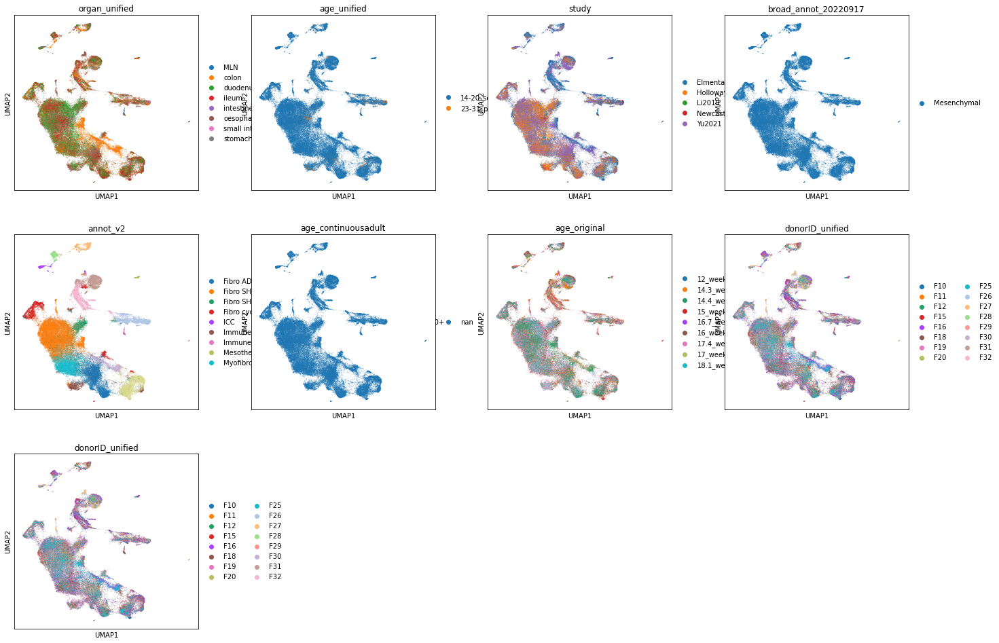

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousadult','age_original','donorID_unified','donorID_unified'],cmap='OrRd')

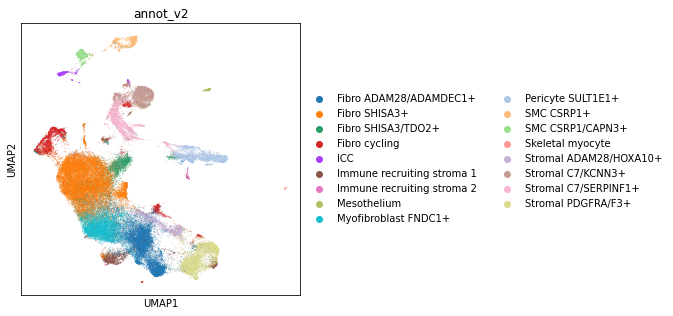

In [5]:
sc.pl.umap(adata,color='annot_v2')

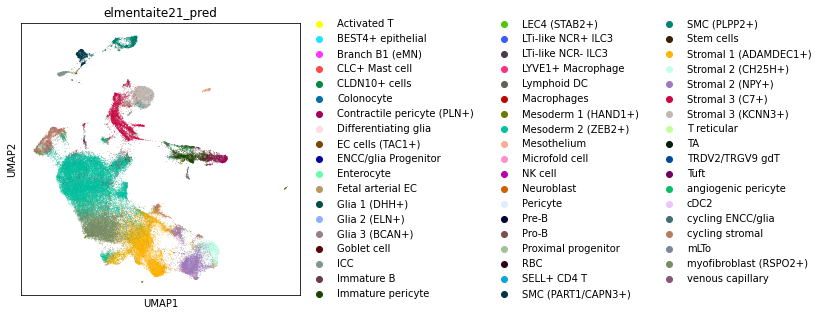

In [22]:
sc.pl.umap(adata, color=['elmentaite21_pred'])

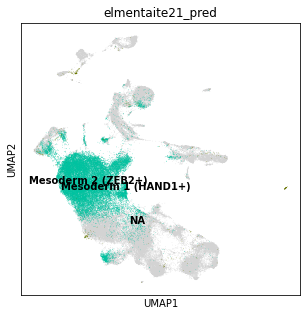

In [26]:
sc.pl.umap(adata, color=['elmentaite21_pred'],groups=['Mesoderm 1 (HAND1+)','Mesoderm 2 (ZEB2+)'],legend_loc='on data')

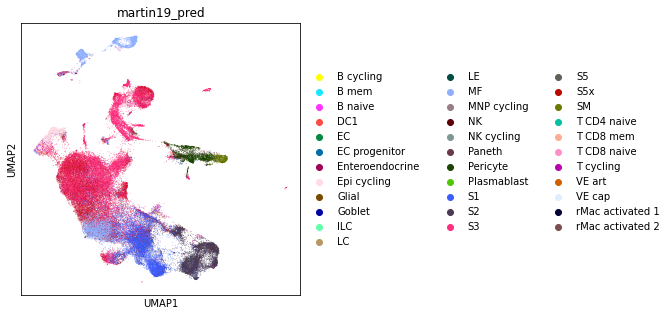

In [25]:
sc.pl.umap(adata, color=['martin19_pred'])

In [7]:
adata.X.max()

4765.0

In [8]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [9]:
adata.X.max()

8.83931

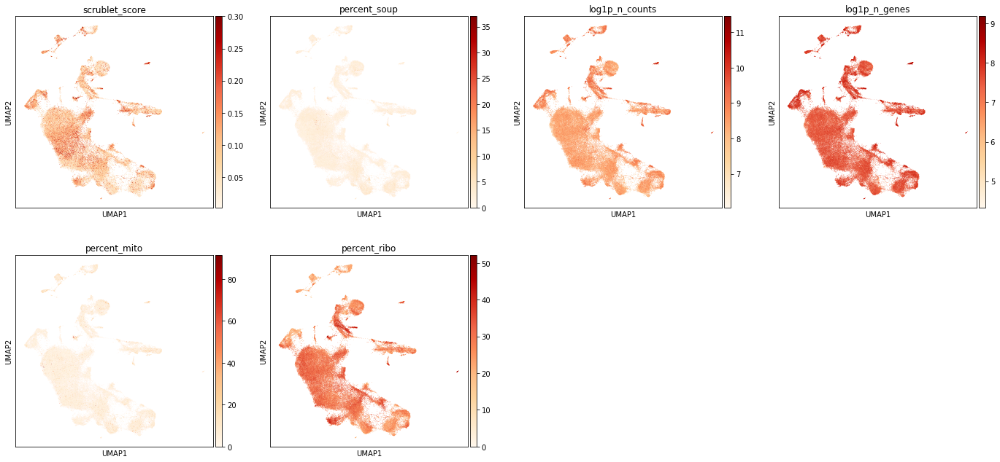

In [10]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

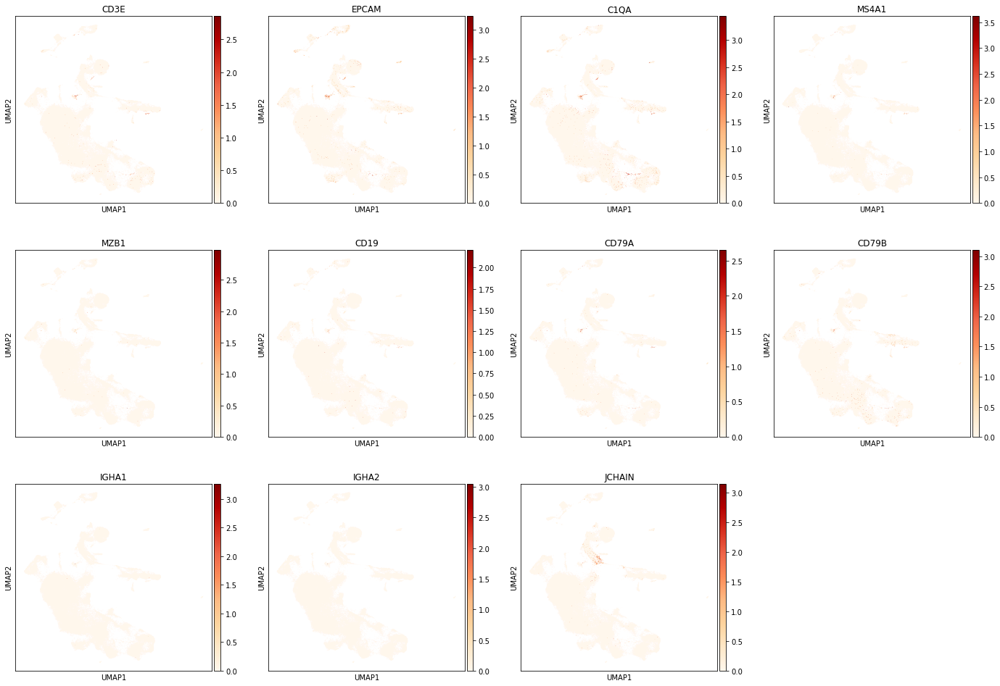

In [11]:
#plot doublet genes
sc.pl.umap(adata, color = ['CD3E','EPCAM','C1QA','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2','JCHAIN'],cmap='OrRd')

In [12]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [13]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

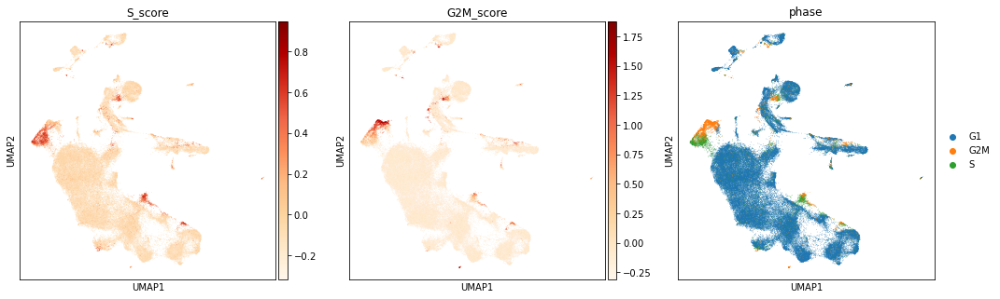

In [14]:
sc.pl.umap(adata,color=['S_score', 'G2M_score', 'phase'],cmap='OrRd')

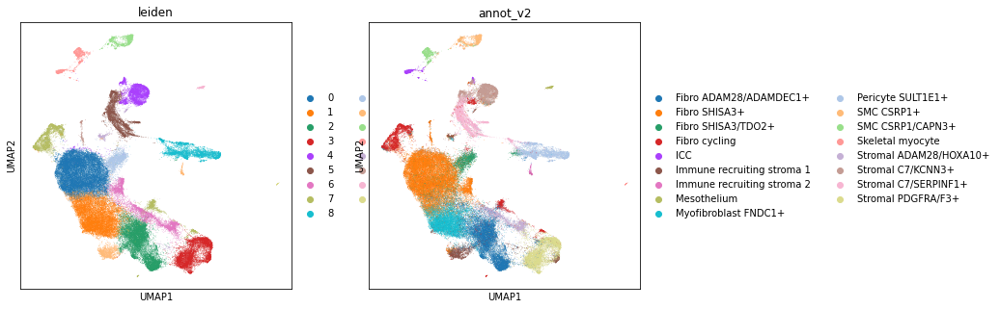

In [15]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(adata,color=['leiden','annot_v2'])

In [16]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

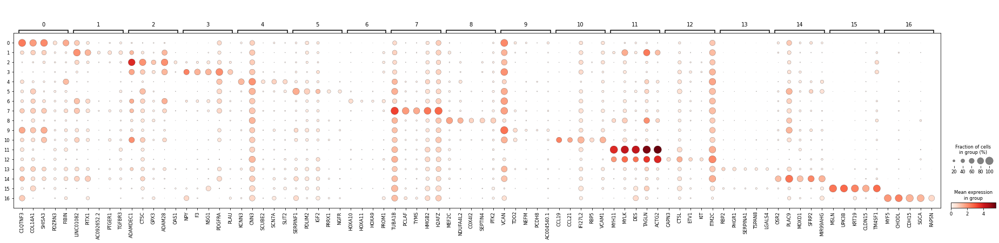

In [17]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

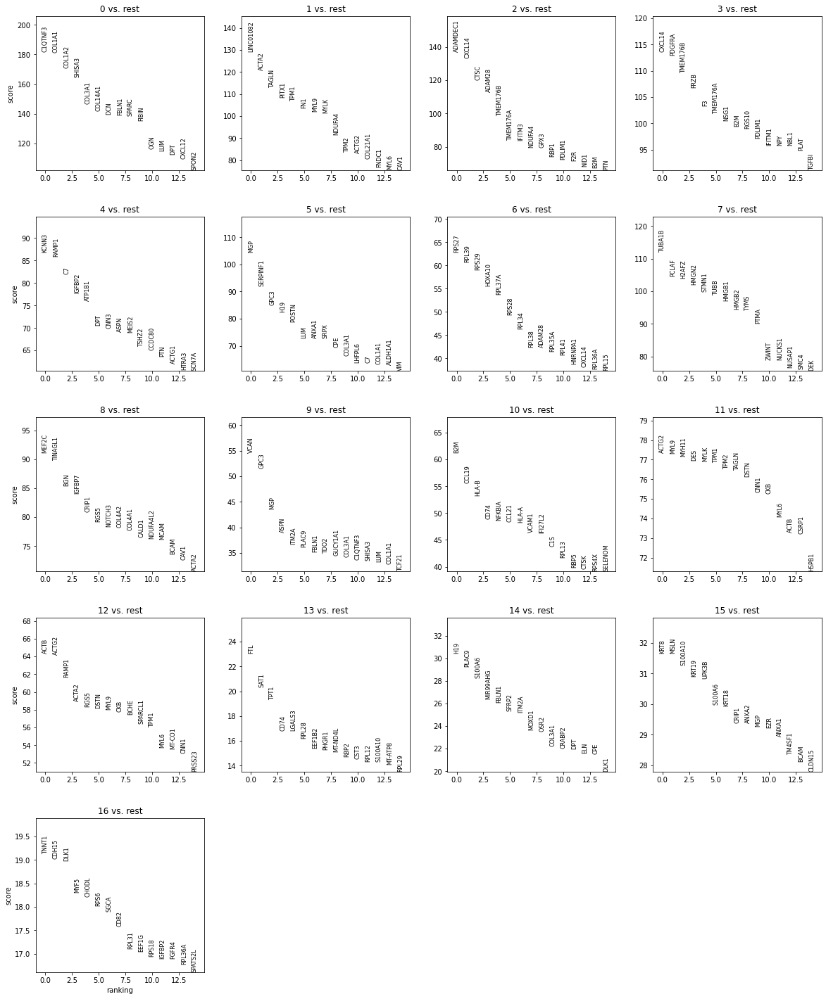

In [18]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

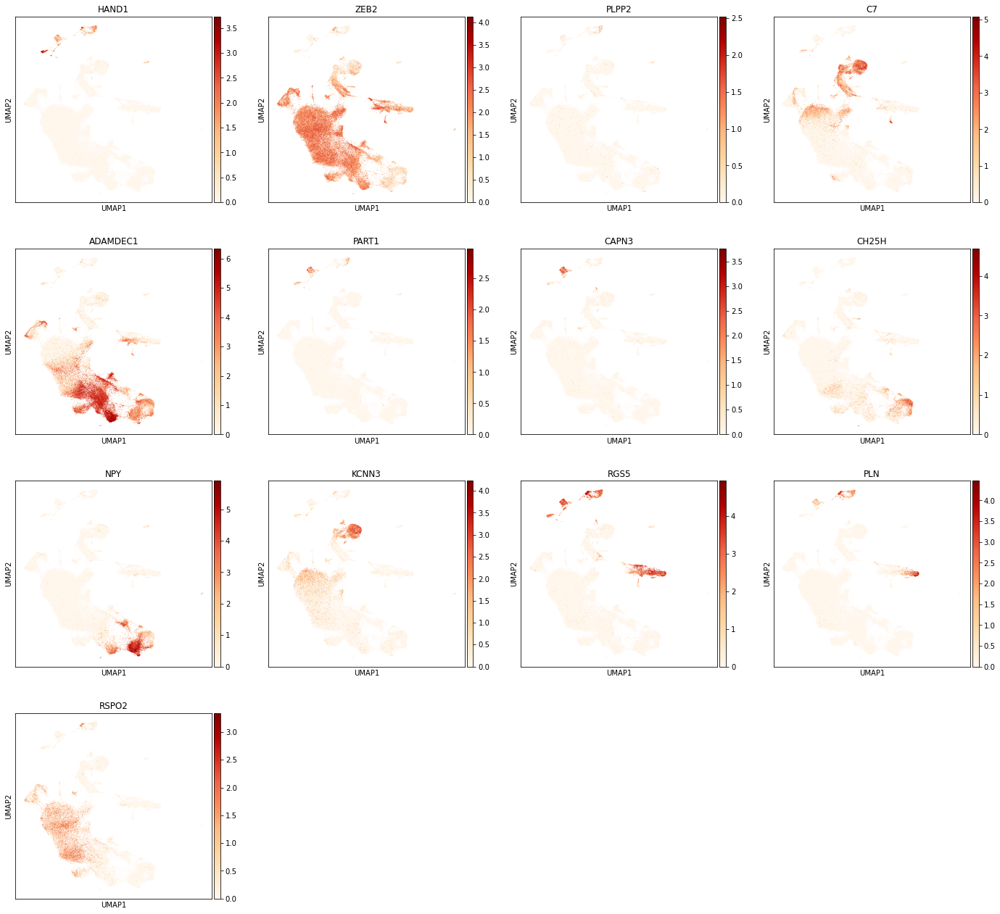

In [19]:
sc.pl.umap(adata,color=['HAND1',
'ZEB2',
'PLPP2',
'C7',
'ADAMDEC1',
'PART1', 'CAPN3',
'CH25H',
'NPY',
'KCNN3',
'RGS5',
'PLN',
'RSPO2'],cmap='OrRd')

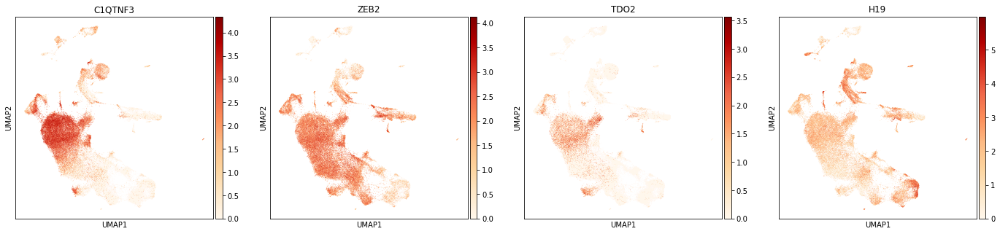

In [28]:
sc.pl.umap(adata,color=['C1QTNF3','ZEB2','TDO2','H19'],cmap='OrRd')

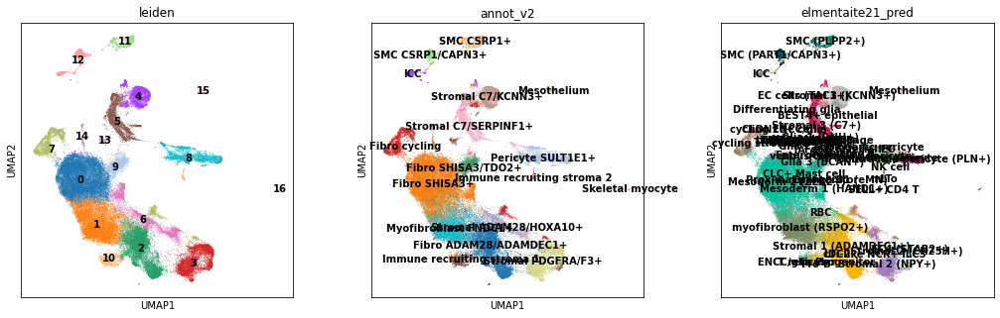

In [20]:
sc.pl.umap(adata,color=['leiden','annot_v2','elmentaite21_pred'],legend_loc='on data')

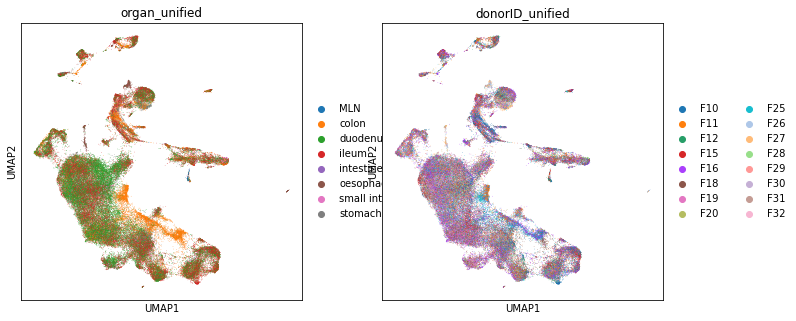

In [21]:
sc.pl.umap(adata,color=['organ_unified','donorID_unified'])

In [29]:
pd.crosstab(adata.obs.elmentaite21_pred,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
elmentaite21_pred,,,,,,,,,,,,,,,,,
Activated T,0,0,1,1,0,0,0,0,1,0,0,1,0,4,0,0,0
BEST4+ epithelial,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0
Branch B1 (eMN),1,0,3,2,2,0,0,1,0,0,1,0,0,1,0,0,0
CLC+ Mast cell,4,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
CLDN10+ cells,0,0,0,0,0,0,0,2,0,0,0,0,0,0,4,0,1
Colonocyte,0,0,0,1,0,0,0,0,1,0,0,0,0,5,0,0,0
Contractile pericyte (PLN+),0,1,0,1,0,0,0,1,1530,0,0,1,1,0,0,0,0
Differentiating glia,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0
EC cells (TAC1+),0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0


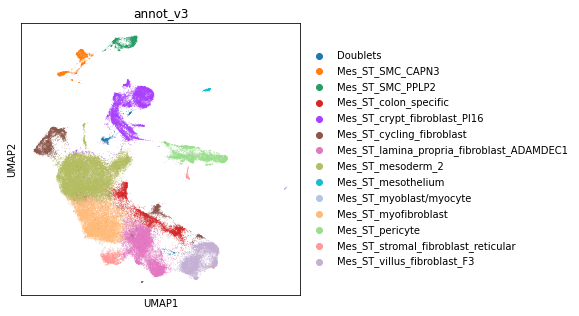

In [30]:
new_cluster_names = [
    'Mes_ST_mesoderm_2','Mes_ST_myofibroblast', #0,1
    'Mes_ST_lamina_propria_fibroblast_ADAMDEC1','Mes_ST_villus_fibroblast_F3', #2,3
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_crypt_fibroblast_PI16', #4,5
    'Mes_ST_colon_specific','Mes_ST_cycling_fibroblast', #6,7 
    'Mes_ST_pericyte','Mes_ST_mesoderm_2',#8,9
    'Mes_ST_stromal_fibroblast_reticular','Mes_ST_SMC_PPLP2',#10,11
    'Mes_ST_SMC_CAPN3','Doublets',#12,13
    'Mes_ST_mesoderm_2','Mes_ST_mesothelium',#14,15
    'Mes_ST_myoblast/myocyte'



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]
sc.pl.umap(adata,color='annot_v3')

In [31]:
meso2 = adata[adata.obs.annot_v3.isin(['Mes_ST_mesoderm_2'])].copy()

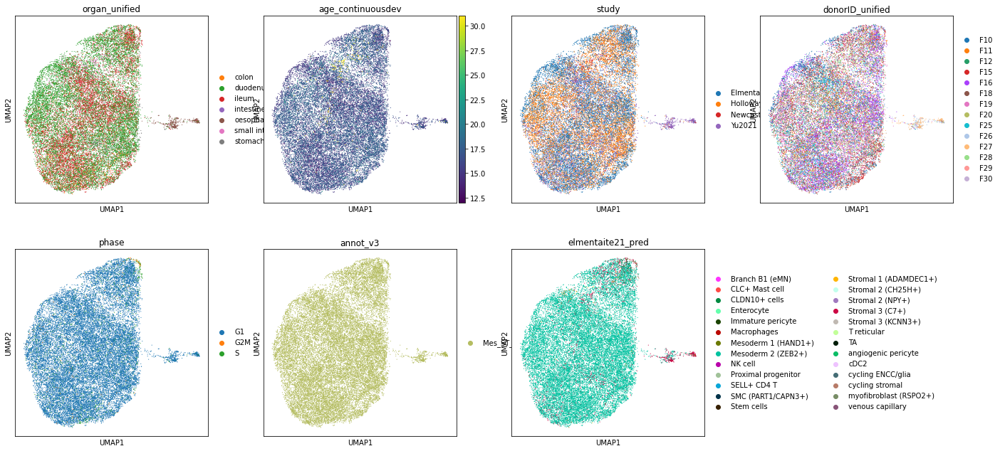

In [32]:
sc.pp.neighbors(
        meso2,
            use_rep="X_scvi",
            n_pcs=meso2.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(meso2, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(meso2, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

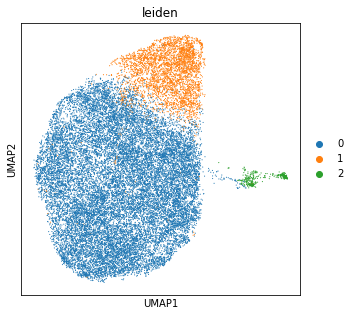

In [34]:
sc.tl.leiden(meso2, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(meso2, color=['leiden'])

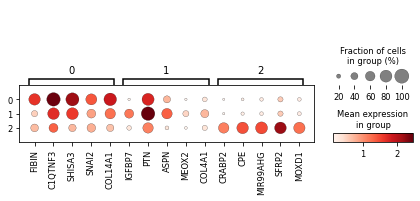

In [35]:
meso2.raw = meso2.copy()
mkst = calc_marker_stats(meso2, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(meso2, groupby='leiden', mks=mks)

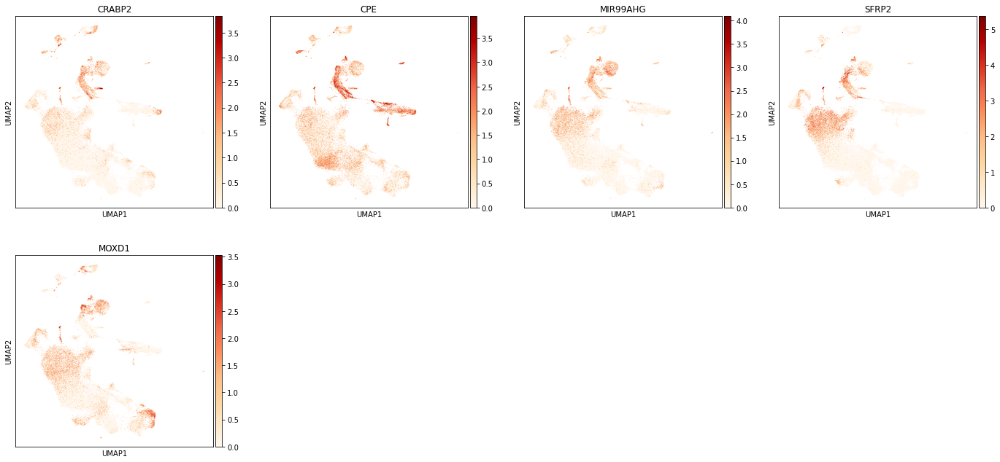

In [37]:
sc.pl.umap(adata,color=['CRABP2','CPE','MIR99AHG','SFRP2','MOXD1'],cmap='OrRd')

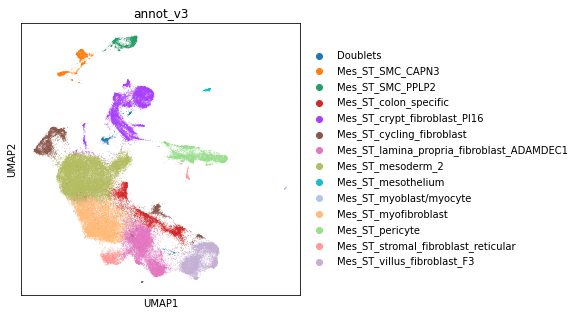

In [38]:
#Rename oesophagus mesoderm to fibroblast - Mes_ST_crypt_fibroblast_PI16, cluster 2 above equivalent to cluster 14 in full adata
new_cluster_names = [
    'Mes_ST_mesoderm_2','Mes_ST_myofibroblast', #0,1
    'Mes_ST_lamina_propria_fibroblast_ADAMDEC1','Mes_ST_villus_fibroblast_F3', #2,3
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_crypt_fibroblast_PI16', #4,5
    'Mes_ST_colon_specific','Mes_ST_cycling_fibroblast', #6,7 
    'Mes_ST_pericyte','Mes_ST_mesoderm_2',#8,9
    'Mes_ST_stromal_fibroblast_reticular','Mes_ST_SMC_PPLP2',#10,11
    'Mes_ST_SMC_CAPN3','Doublets',#12,13
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_mesothelium',#14,15
    'Mes_ST_myoblast/myocyte'



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]
sc.pl.umap(adata,color='annot_v3')

In [39]:
fibro = adata[adata.obs.annot_v3.isin(['Mes_ST_mesoderm_2','Mes_ST_lamina_propria_fibroblast_ADAMDEC1','Mes_ST_colon_specific','Mes_ST_villus_fibroblast_F3'])].copy()

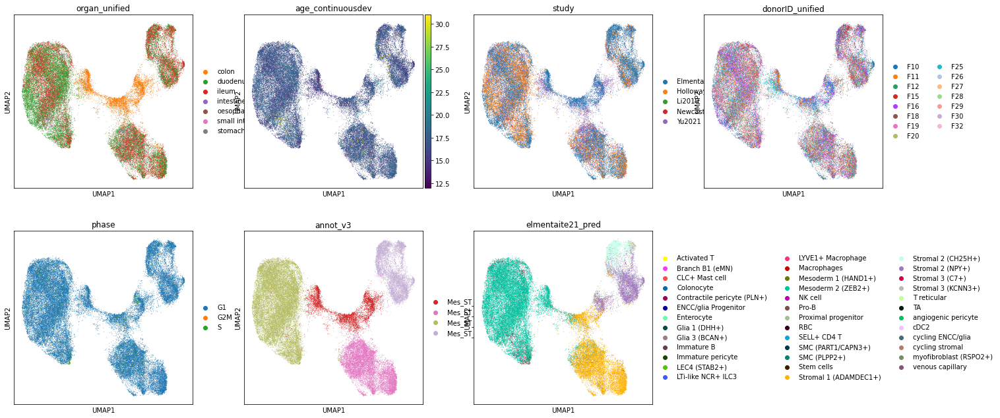

In [40]:
sc.pp.neighbors(
        fibro,
            use_rep="X_scvi",
            n_pcs=fibro.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(fibro, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(fibro, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

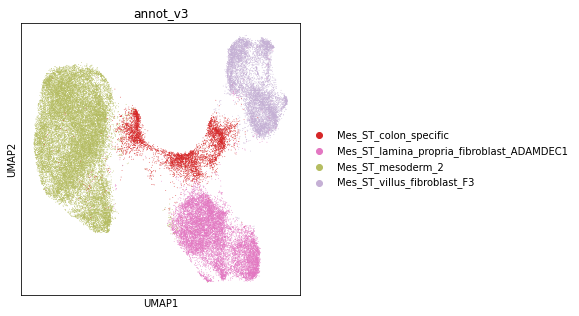

In [46]:
sc.pl.umap(fibro,color='annot_v3')

In [41]:
colon = adata[adata.obs.annot_v3.isin(['Mes_ST_colon_specific'])].copy()

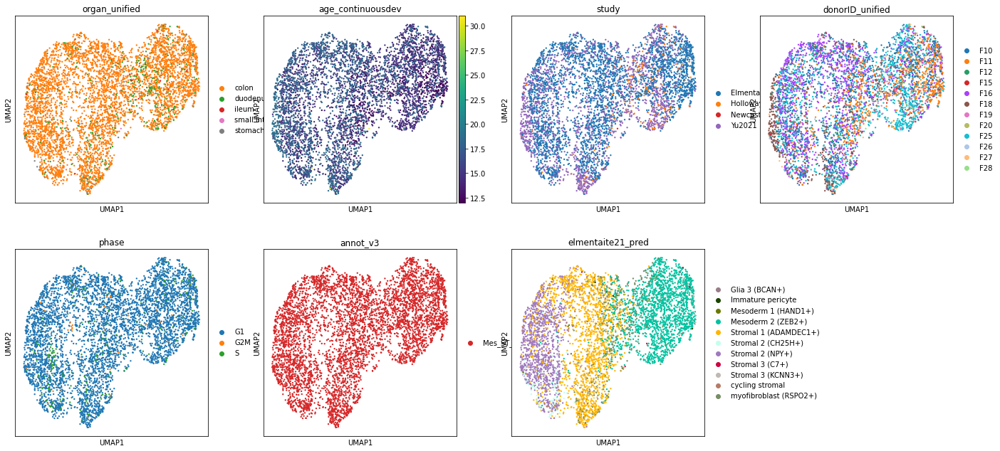

In [42]:
sc.pp.neighbors(
        colon,
            use_rep="X_scvi",
            n_pcs=colon.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(colon, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(colon, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

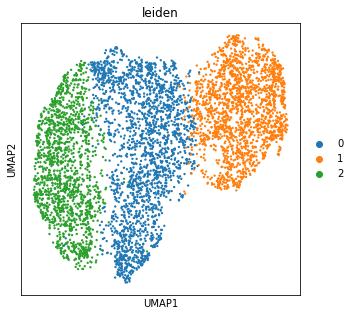

In [43]:
sc.tl.leiden(colon, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(colon, color=['leiden'])

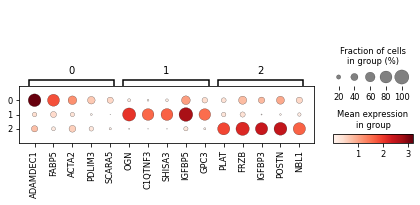

In [44]:
colon.raw = colon.copy()
mkst = calc_marker_stats(colon, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(colon, groupby='leiden', mks=mks)

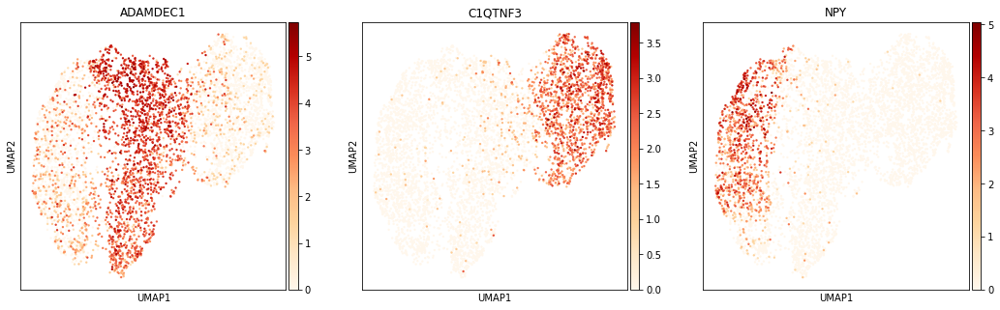

In [45]:
sc.pl.umap(colon,color=['ADAMDEC1','C1QTNF3','NPY'],cmap='OrRd')

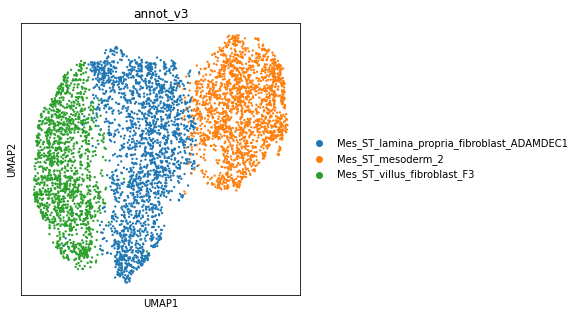

In [47]:
new_cluster_names = [
    'Mes_ST_lamina_propria_fibroblast_ADAMDEC1','Mes_ST_mesoderm_2', #0,1
    'Mes_ST_villus_fibroblast_F3' #2



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

colon.obs['annot_v3'] = [conv[x] for x in colon.obs['leiden']]
sc.pl.umap(colon,color='annot_v3')

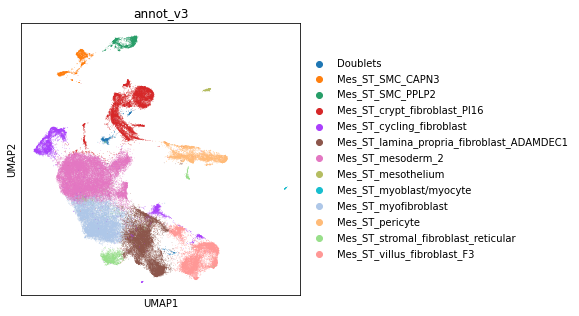

In [49]:
ON = {O:N for O,N in zip(colon.obs_names,colon.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [77]:
peri = adata[adata.obs.annot_v3.isin(['Mes_ST_pericyte','Mes_ST_stromal_fibroblast_reticular'])].copy()

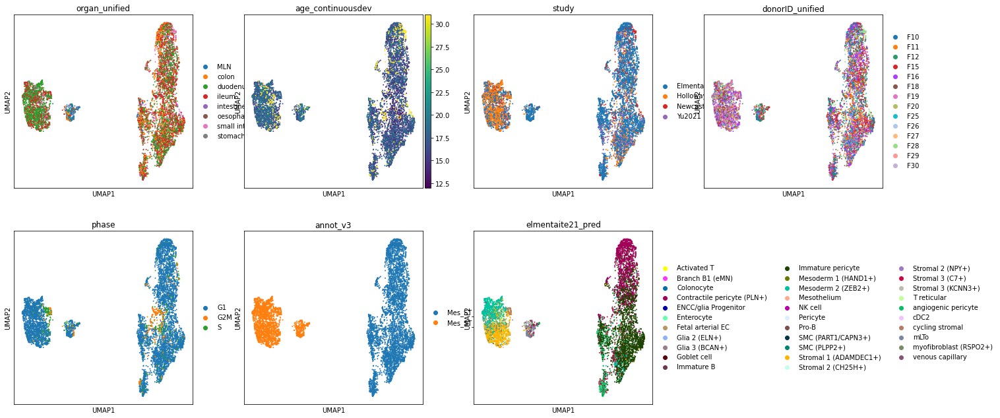

In [78]:
sc.pp.neighbors(
        peri,
            use_rep="X_scvi",
            n_pcs=peri.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(peri, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(peri, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

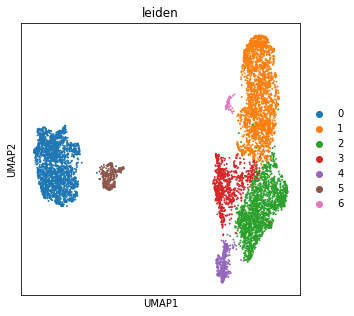

In [79]:
sc.tl.leiden(peri, resolution = 0.4, neighbors_key="neighbors_scvi")
sc.pl.umap(peri, color=['leiden'])

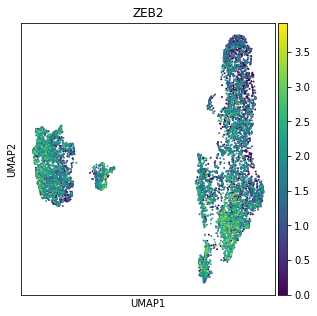

In [82]:
sc.pl.umap(peri,color=['ZEB2'])

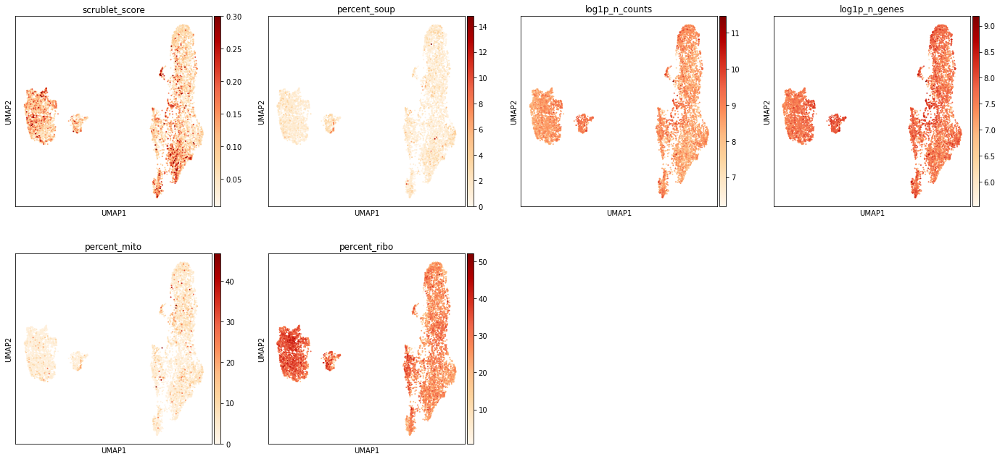

In [83]:
#plot some basic QC
sc.pl.umap(peri, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

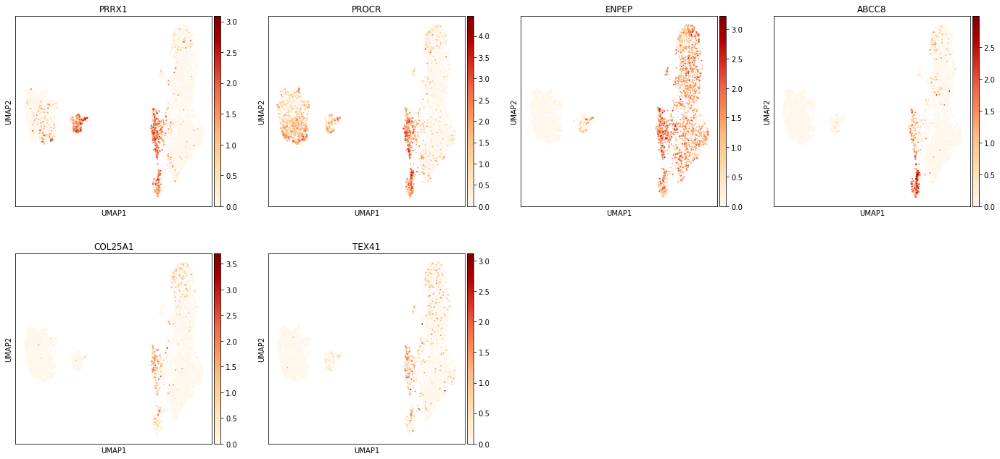

In [84]:
sc.pl.umap(peri,color=['PRRX1','PROCR','ENPEP','ABCC8','COL25A1','TEX41'],cmap='OrRd')

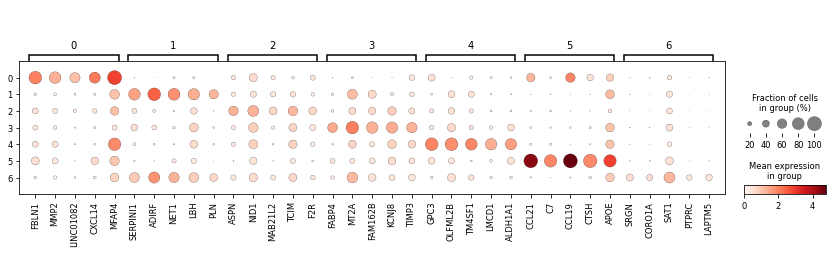

In [80]:
peri.raw = peri.copy()
mkst = calc_marker_stats(peri, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(peri, groupby='leiden', mks=mks)

         Falling back to preprocessing with `sc.pp.pca` and default params.


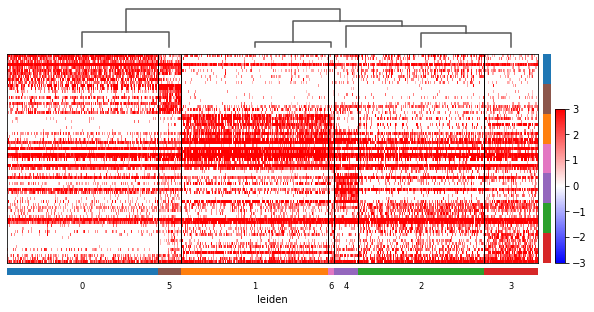

In [85]:
sc.tl.rank_genes_groups(peri,groupby='leiden',method='wilcoxon')
sc.tl.dendrogram(peri, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(peri,groupby='leiden', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

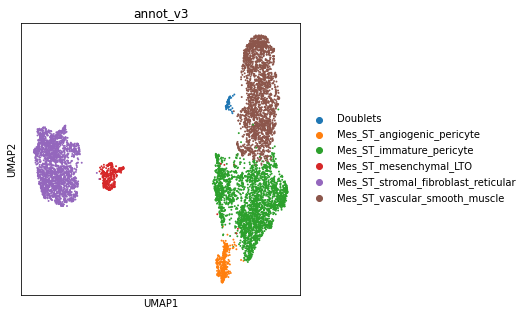

In [86]:
new_cluster_names = [
    'Mes_ST_stromal_fibroblast_reticular','Mes_ST_vascular_smooth_muscle', #0,1
    'Mes_ST_immature_pericyte','Mes_ST_immature_pericyte', #2,3
    'Mes_ST_angiogenic_pericyte','Mes_ST_mesenchymal_LTO', #4,5
    'Doublets'



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

peri.obs['annot_v3'] = [conv[x] for x in peri.obs['leiden']]
sc.pl.umap(peri,color='annot_v3')

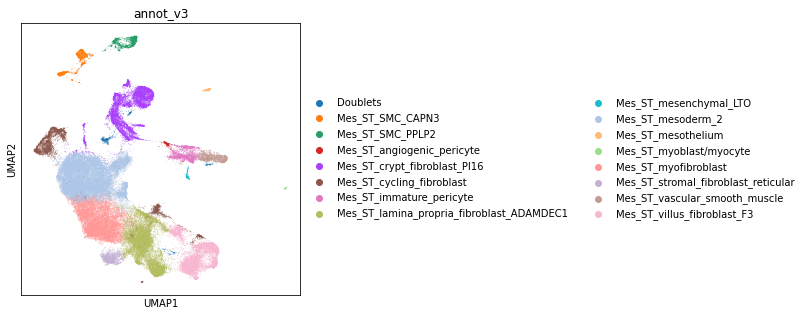

In [87]:
ON = {O:N for O,N in zip(peri.obs_names,peri.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

Check for doublets

In [88]:
cf = adata[adata.obs.annot_v3.isin(['Mes_ST_crypt_fibroblast_PI16'])].copy()

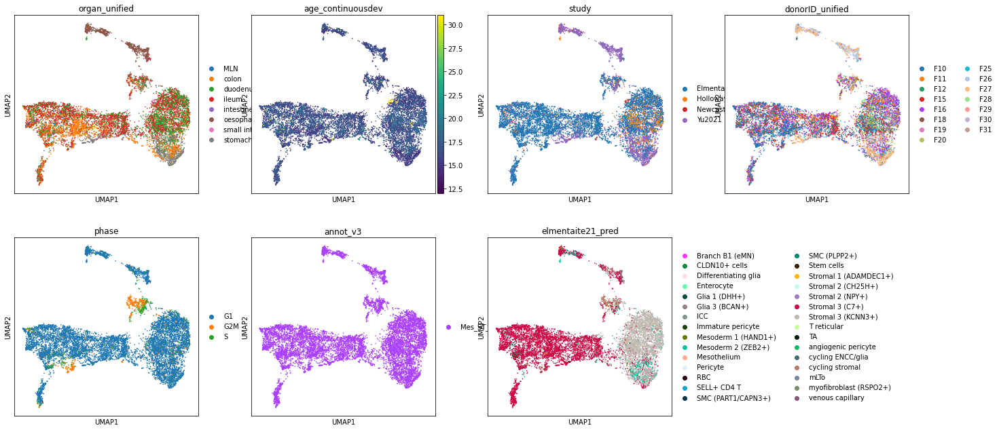

In [89]:
sc.pp.neighbors(
        cf,
            use_rep="X_scvi",
            n_pcs=cf.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cf, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cf, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

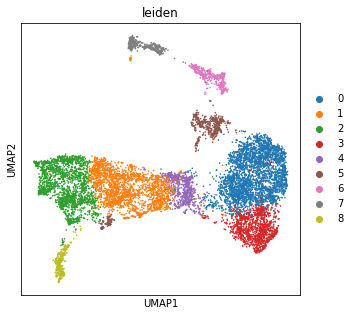

In [90]:
sc.tl.leiden(cf, resolution = 0.4, neighbors_key="neighbors_scvi")
sc.pl.umap(cf, color=['leiden'])

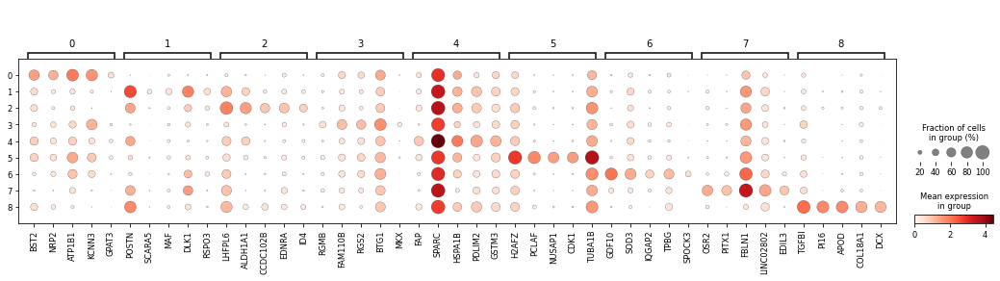

In [91]:
cf.raw = cf.copy()
mkst = calc_marker_stats(cf, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cf, groupby='leiden', mks=mks)

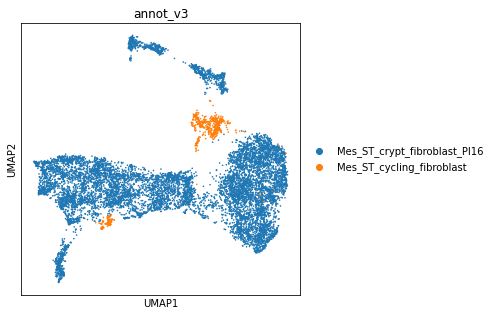

In [92]:
new_cluster_names = [
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_crypt_fibroblast_PI16', #0,1
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_crypt_fibroblast_PI16', #2,3
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_cycling_fibroblast', #4,5
    'Mes_ST_crypt_fibroblast_PI16','Mes_ST_crypt_fibroblast_PI16',#6,7
    'Mes_ST_crypt_fibroblast_PI16'



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cf.obs['annot_v3'] = [conv[x] for x in cf.obs['leiden']]
sc.pl.umap(cf,color='annot_v3')

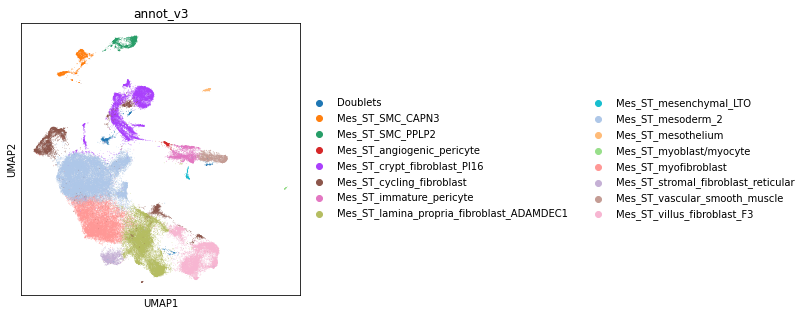

In [93]:
ON = {O:N for O,N in zip(cf.obs_names,cf.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [94]:
lpf = adata[adata.obs.annot_v3.isin(['Mes_ST_lamina_propria_fibroblast_ADAMDEC1'])].copy()

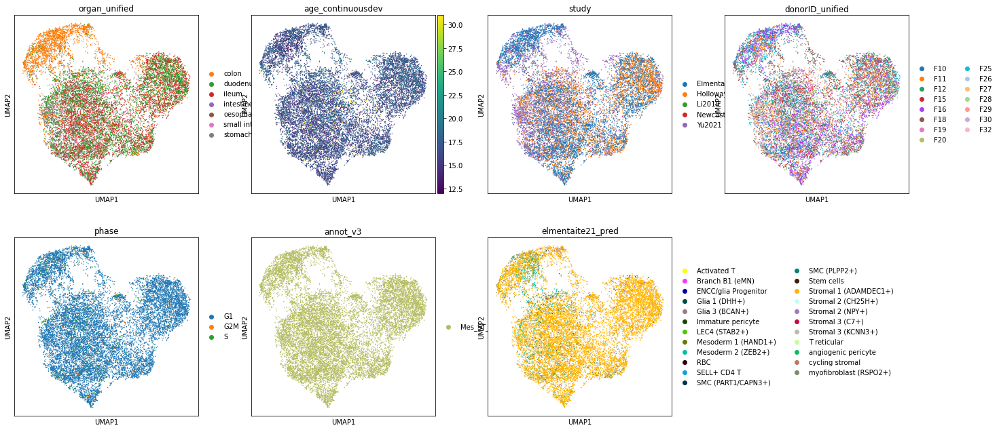

In [97]:
sc.pp.neighbors(
        lpf,
            use_rep="X_scvi",
            n_pcs=lpf.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(lpf, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(lpf, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

In [96]:
vf = adata[adata.obs.annot_v3.isin(['Mes_ST_villus_fibroblast_F3'])].copy()

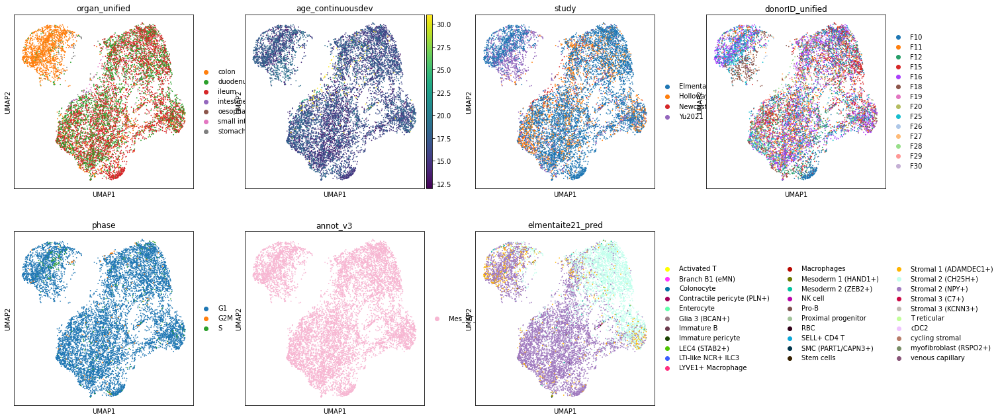

In [98]:
sc.pp.neighbors(
        vf,
            use_rep="X_scvi",
            n_pcs=vf.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(vf, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(vf, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

In [99]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_ST.hvg5000_noRPL.scvi_output.annotv3.20230106.h5ad')

In [100]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [101]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Mes_ST_annot_v3.csv')

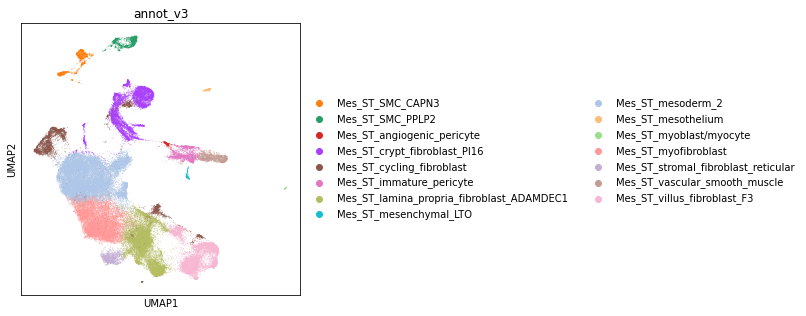

In [102]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [103]:
adata_nodoublets.X.max()

8.83931

In [104]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [105]:
adata_nodoublets.X.max()

4765.0

In [106]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Mes_ST.raw.annotv3.nodoublets.20230106.h5ad')

In [3]:
#make plots for figures

In [4]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_ST.hvg5000_noRPL.scvi_output.annotv3.20230106.h5ad')

In [5]:
annot = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/healthy_annotations_level1to3_20230127.csv',index_col=0)

In [6]:
adata.obs['fine_annot'] = annot.level_3_annot

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


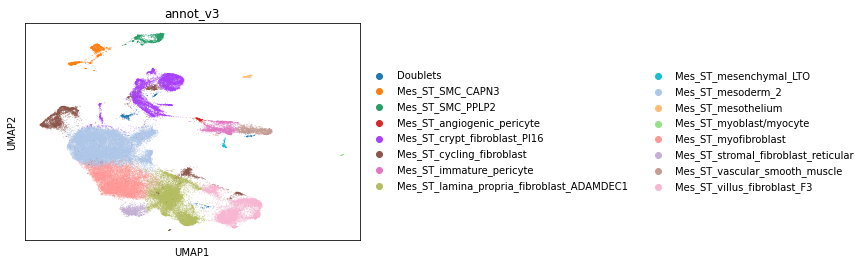

In [7]:
sc.pl.umap(adata,color='annot_v3')

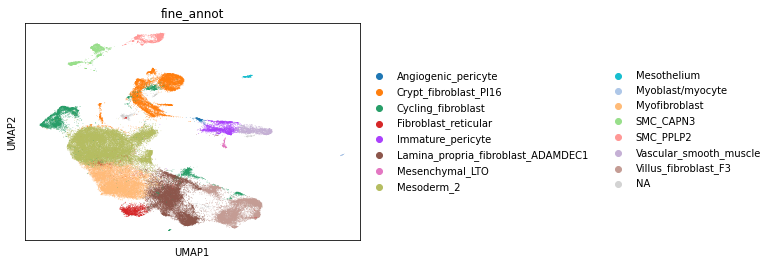

In [8]:
sc.pl.umap(adata,color='fine_annot')

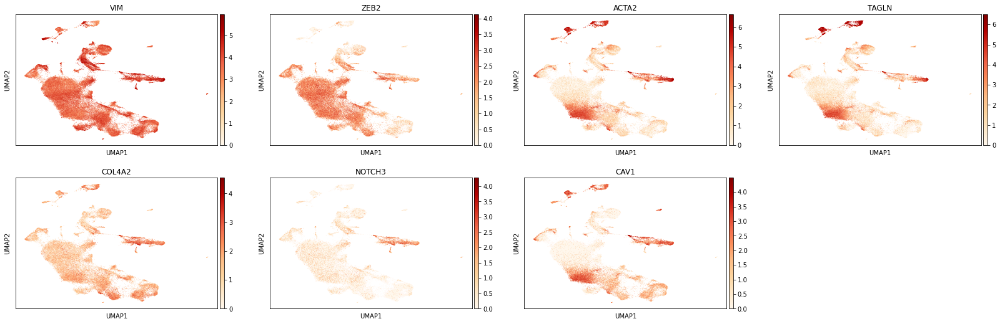

In [9]:
sc.pl.umap(adata,color=['VIM','ZEB2','ACTA2','TAGLN','COL4A2','NOTCH3','CAV1'],cmap='OrRd')

In [10]:
adata.obs.fine_annot.cat.categories

Index(['Angiogenic_pericyte', 'Crypt_fibroblast_PI16', 'Cycling_fibroblast',
       'Fibroblast_reticular', 'Immature_pericyte',
       'Lamina_propria_fibroblast_ADAMDEC1', 'Mesenchymal_LTO', 'Mesoderm_2',
       'Mesothelium', 'Myoblast/myocyte', 'Myofibroblast', 'SMC_CAPN3',
       'SMC_PPLP2', 'Vascular_smooth_muscle', 'Villus_fibroblast_F3'],
      dtype='object')

In [11]:
adata.obs['fine_annot'].cat.reorder_categories(['Vascular_smooth_muscle','Immature_pericyte','Angiogenic_pericyte','SMC_CAPN3', 
       'SMC_PPLP2','Myofibroblast','Myoblast/myocyte', 'Villus_fibroblast_F3',
                                                'Crypt_fibroblast_PI16','Lamina_propria_fibroblast_ADAMDEC1',
                                             'Mesoderm_2','Cycling_fibroblast',
       'Mesothelium',    
                                                
     'Fibroblast_reticular', 
        'Mesenchymal_LTO', 
  
       ], inplace=True)


<ipython-input-11-e34d09d91579>:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['fine_annot'].cat.reorder_categories(['Vascular_smooth_muscle','Immature_pericyte','Angiogenic_pericyte','SMC_CAPN3',


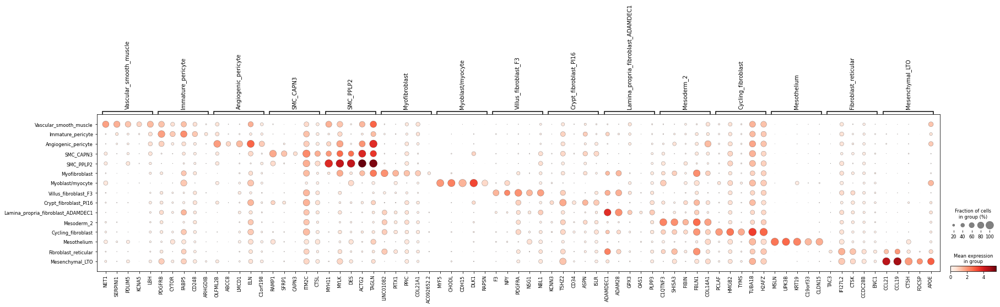

In [12]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="fine_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_annot', mks=mks)

In [13]:
marker_genes_dict = {
    
                     'Vascular_smooth_muscle':['RERGL','MUSTN1','LBH','NET1','MAP3K20'],
                     'Pericyte':['NDUFA4L2','PDGFRB','FABP5'],
    'Angiogenic pericyte':['OLFML2B','ELN','NOTCH3','CAV1'],
    'SMC_CAPN3':['CAPN3','HSPB6','SFRP1'],
                     
    'SMC_PLPP2':['PLPP2','MYH11','HACD1','GBP2'],
                     'Myofibroblast':['ACTG2','TAGLN','PITX1','PPIC','COL21A1'],
    'Myoblast/myocyte':['MYF5','CHODL','CDH15','DLK1','RAPSN'],
                     'Villus_fibroblast_F3':['F3','PDGFRA'],
                     'Crypt_fibroblast_PI16':['C7','SFRP2'],
                     'Lamina_propria_fibroblast_ADAMDEC1':['ADAMDEC1','ADAM28'],
    
   'Mesoderm_2':['ZEB2','FIBIN','C1QTNF3'],
     'cycling markers':['TOP2A','MKI67'],
              'Mesothelium':['UPK3B','MSLN','SLPI','KRT19'],
    'Stromal_fibroblast_retictular':['TAC3','CTSK','TNFSF13B','TDO2'],
    'Mesenchymal_LTO':['CCL21','CCL19','CTSH','FDCSP','APOE']
    
    
                     
                     
                     
    
                    }

In [14]:
adata = adata[adata.obs.fine_annot.isin(['Angiogenic_pericyte', 'Crypt_fibroblast_PI16', 'Cycling_fibroblast',
       'Fibroblast_reticular', 'Immature_pericyte',
       'Lamina_propria_fibroblast_ADAMDEC1', 'Mesenchymal_LTO', 'Mesoderm_2',
       'Mesothelium', 'Myoblast/myocyte', 'Myofibroblast', 'SMC_CAPN3',
       'SMC_PPLP2', 'Vascular_smooth_muscle', 'Villus_fibroblast_F3'])].copy()


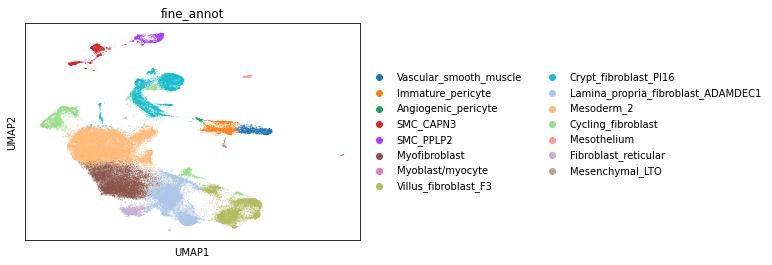

In [15]:
sc.pl.umap(adata,color='fine_annot')

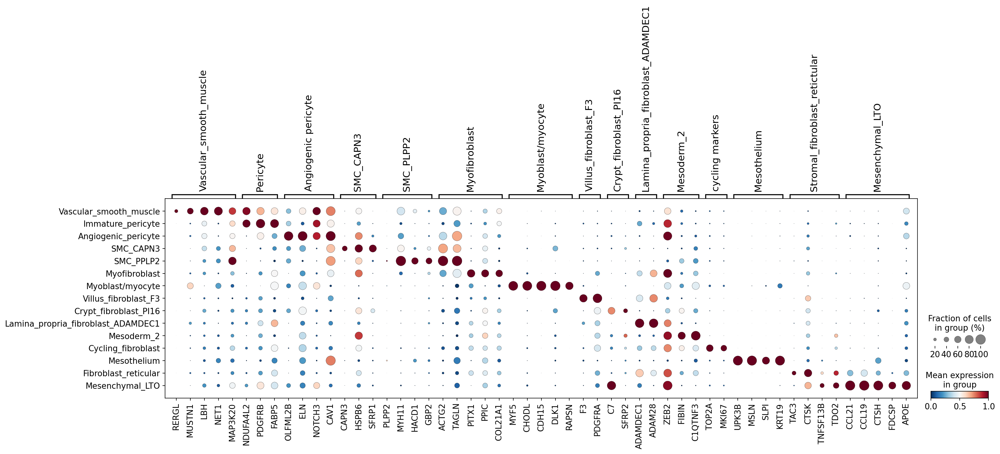

In [16]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_ST_markers.pdf',color_map='RdBu_r', standard_scale='var')

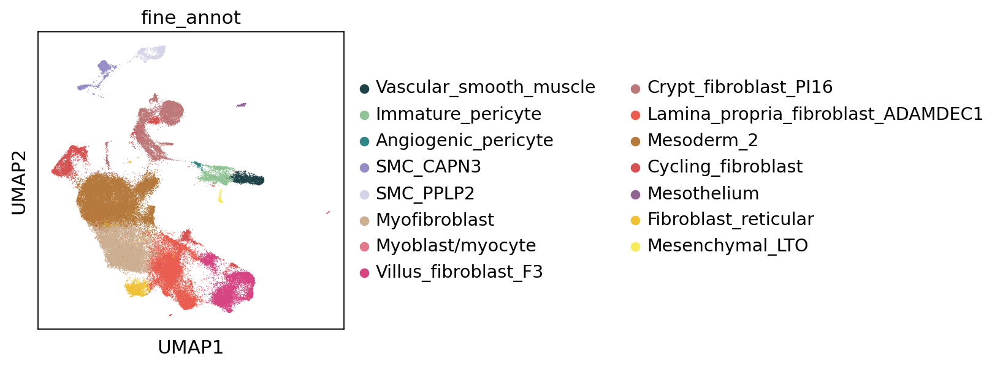

In [17]:
sc.pl.umap(adata,color='fine_annot',palette = [ 
    '#1E4147',#'Vascular_smooth_muscle',
      '#90c496',#'Pericyte',
    '#308587',#  'Angiogenic_pericyte':                     
    '#968dc6',#SMC_CAPN3 
    '#d4d4e8',#  'SMC_PPLP2': 
     '#CCAE91',#'Myofibroblast',  
    '#e2798d',#'Myoblast/myocyte': 
      '#d64582',#'Villus_fibroblast_F3'
     '#bd7879',#'Crypt_fibroblast_PI16', 
     '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
'#b4793b',  #     'Mesoderm_2': 
 '#d65151',#Cycling_fibroblast': 
 '#8F6592',#'Mesothelium', 
'#f0c134',#'Stromal_fibroblast_reticular',
'#f7eb59',# 'Mesenchymal_LTO': 

    
    
          
                                              ])

In [18]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

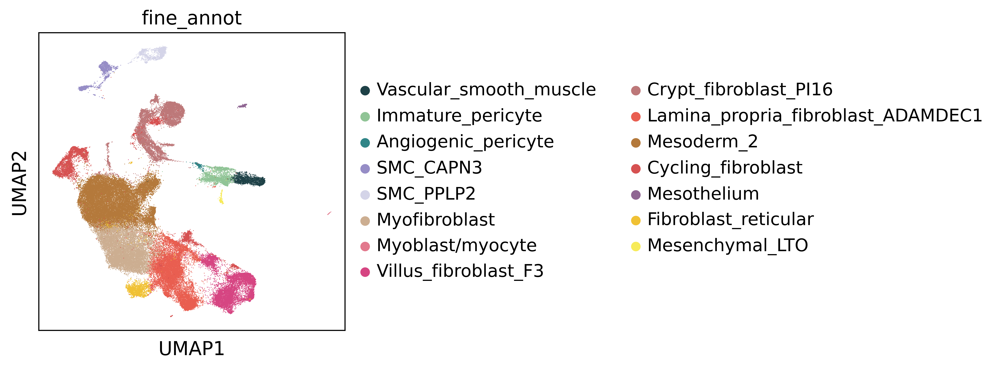

In [19]:
sc.pl.umap(adata,color='fine_annot',save='Mes_ST_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

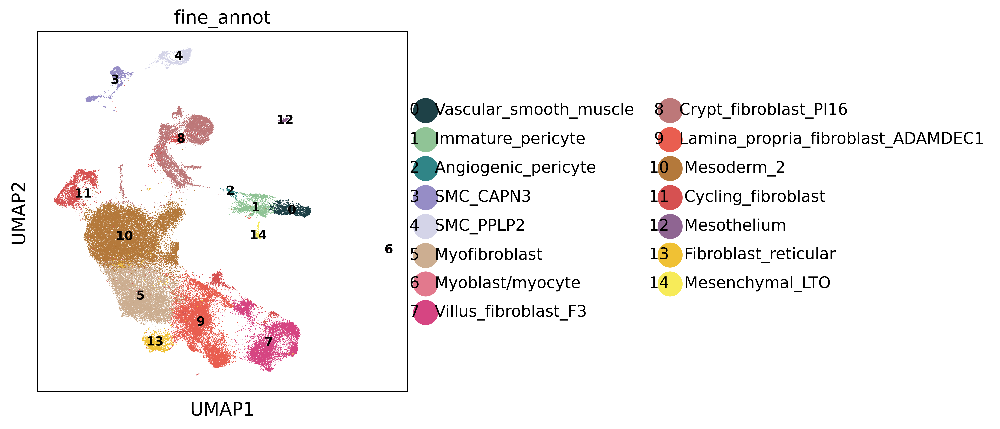

In [20]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/Mes_ST_annot.png')

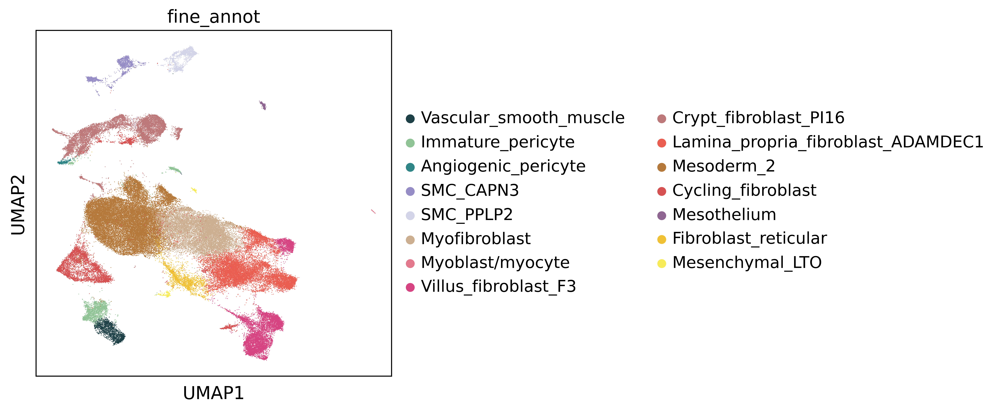

In [21]:
sc.pp.neighbors(
            adata,
            use_rep="X_scvi",
            n_pcs=adata.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(adata, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(adata, color='fine_annot')

In [22]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

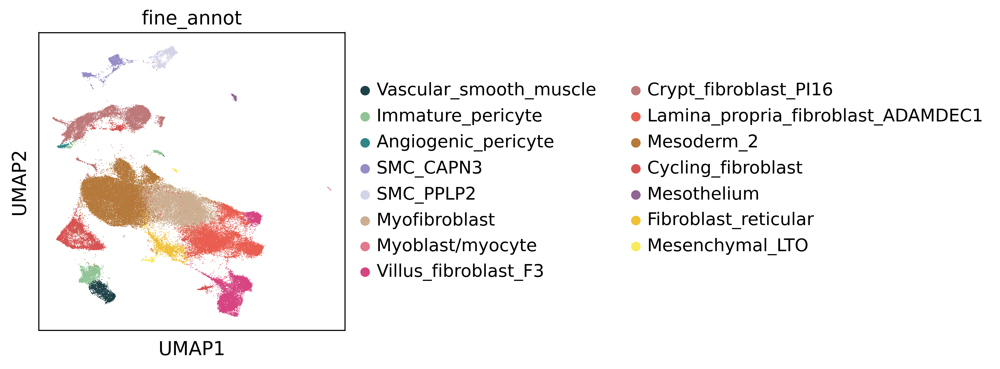

In [23]:
sc.pl.umap(adata,color='fine_annot',save='Mes_ST_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

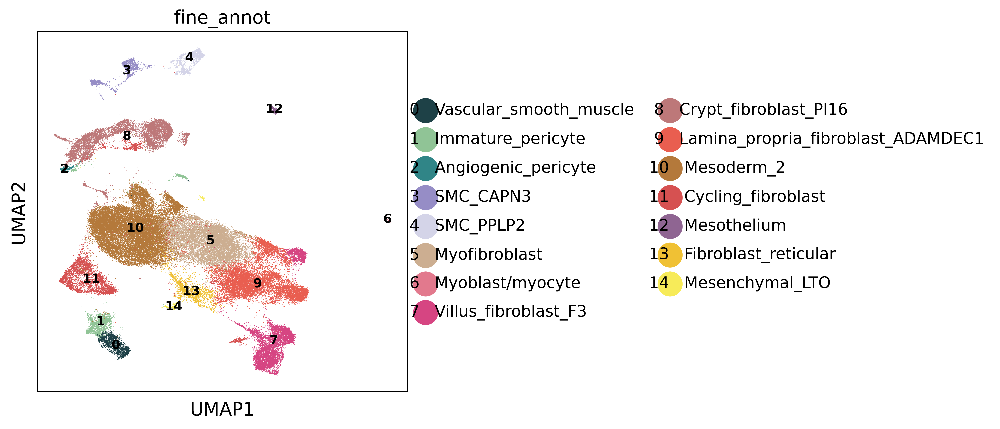

In [24]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/Mes_ST_annot.png')

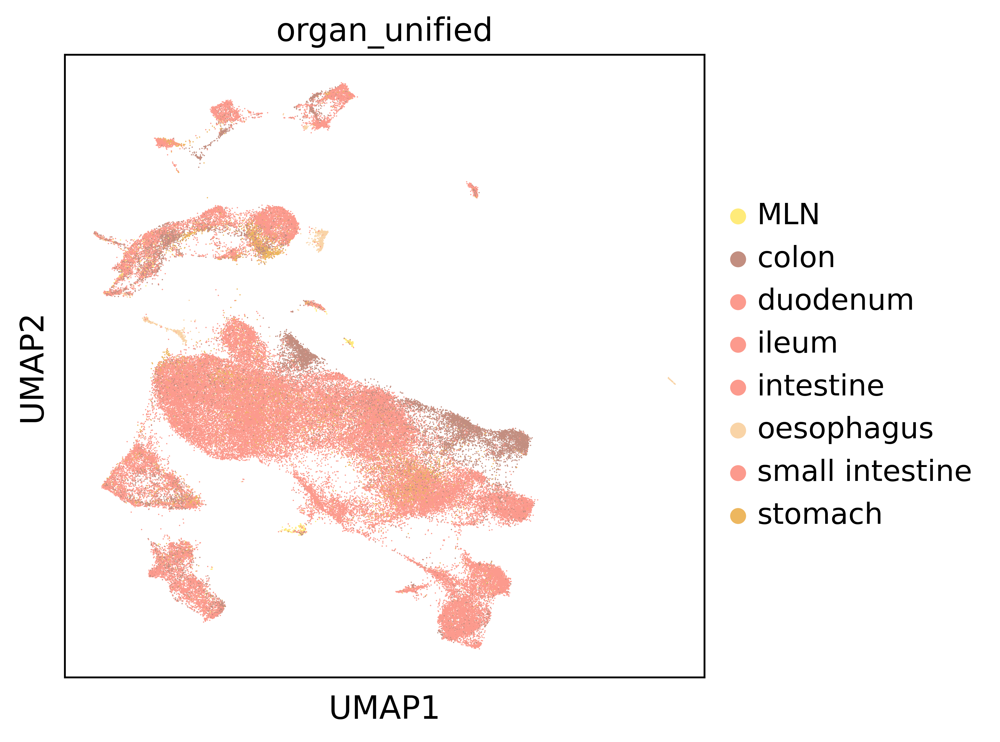

In [32]:
sc.pl.umap(adata,color=['organ_unified'],palette=
          
          [ '#ffeb7a', #MLN
            '#c28e80',#colon
                '#fc9a8d', #duodenum
             '#fc9a8d',#ileum
              '#fc9a8d',#intestine
                '#f9d4a7', #oesophagus
                '#fc9a8d', #small intestine
                '#edb75f', #stomach 
          ])

In [36]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=12,
    frameon=False,
    transparent=True,
)
sns.set_style(style="white")
sns.set_context(context="paper")

In [38]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [41]:
adata.obs['organ_unified'].unique()

['colon', 'stomach', 'oesophagus', 'duodenum', 'ileum', 'MLN', 'small intestine', 'intestine']
Categories (8, object): ['MLN', 'colon', 'duodenum', 'ileum', 'intestine', 'oesophagus', 'small intestine', 'stomach']

In [42]:
adata.obs['organ_groups'] = (
    adata.obs["organ_unified"]
    .map(lambda x: {'colon':'Large_intestine', 'stomach':'Stomach', 'oesophagus':'Oesophagus', 
                    'duodenum':'Small_intestine', 'ileum':'Small_intestine',  'small intestine':'Small_intestine', 
                    'intestine':'Small_intestine'
                    
   }.get(x, x))
    .astype("category")
)

In [43]:
adata.obs['organ_groups'].cat.reorder_categories(['Oesophagus','Stomach','Small_intestine','Large_intestine','MLN'], inplace=True)

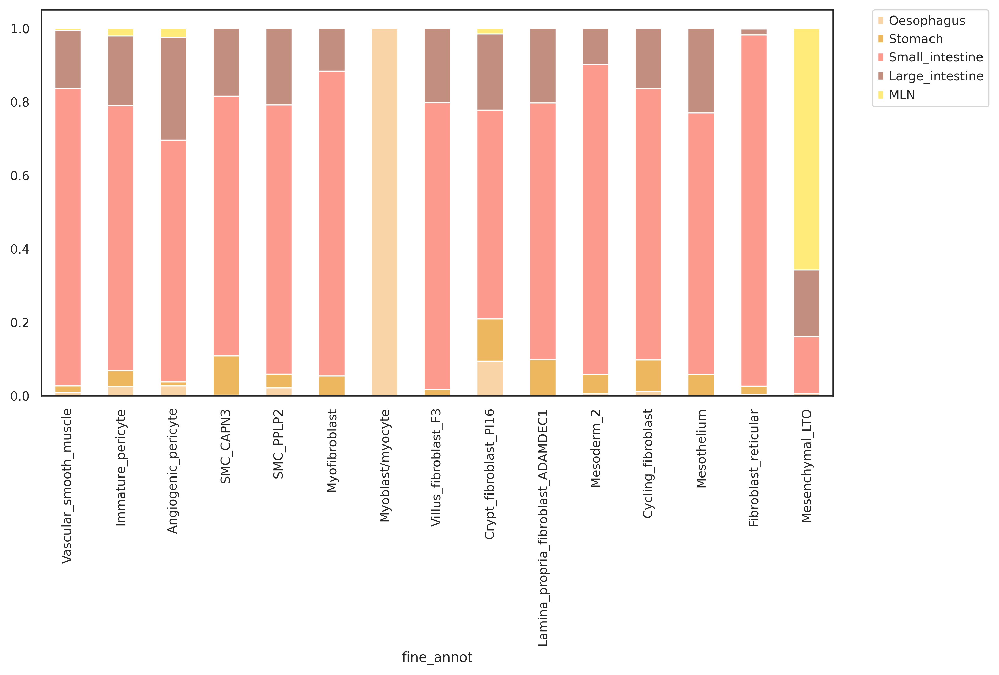

In [44]:
plt.rcParams['figure.figsize'] = [10,5]
tmp = pd.crosstab(adata.obs['fine_annot'], adata.obs['organ_groups'],normalize='index')
tmp.plot.bar(stacked=True, color = [
               '#f9d4a7', #oesophagus
      '#edb75f', #stomach 
'#fc9a8d', #small intestine
     '#c28e80',#colon
      '#ffeb7a', #MLN
     
             
              
]).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/Mes/figures/ST_organ_distribution_bar.pdf')

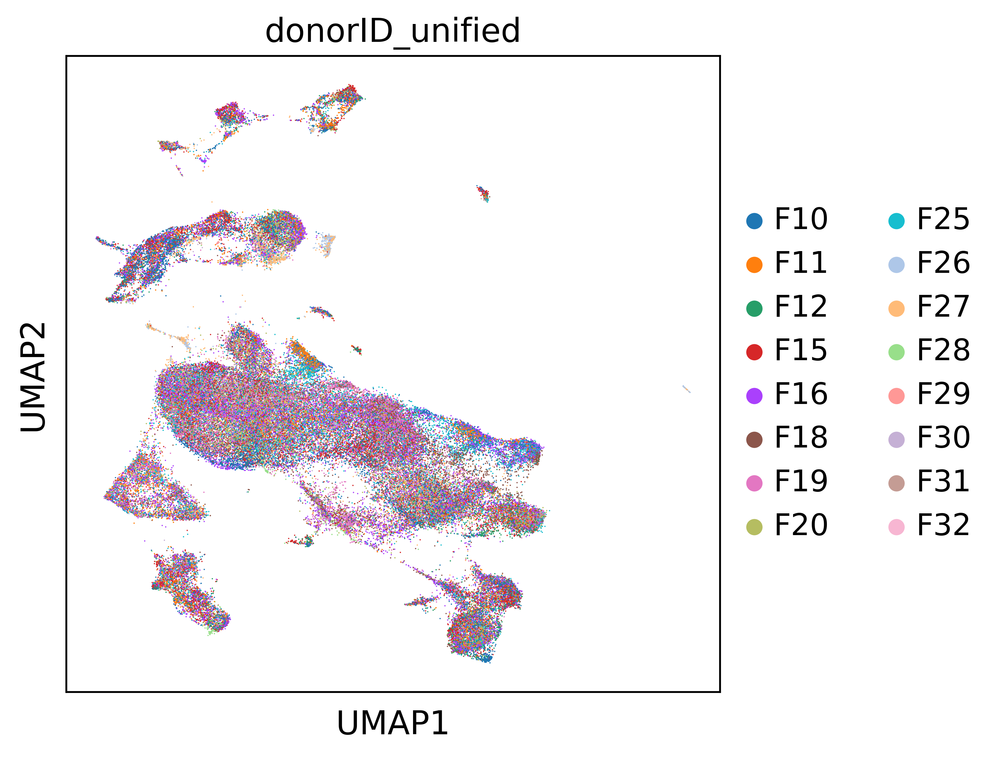

In [26]:
sc.pl.umap(adata,color=['donorID_unified'])